In [ ]:
import pandas as pd
import seaborn as sns

import matplotlib.pyplot as plt

# Load the data from the TSV files
paths_finished = pd.read_csv('wikispeedia_paths-and-graph/paths_finished.tsv', 
                                sep='\t', 
                                comment='#', 
                                names=['hashedIpAddress', 'timestamp', 'durationInSec', 'path', 'rating'])

paths_finished['target'] = paths_finished['path'].apply(lambda x: x.split(';')[-1])
paths_finished['is_finished'] = True


paths_unfinished = pd.read_csv('wikispeedia_paths-and-graph/paths_unfinished.tsv', 
                                sep='\t', 
                                comment='#', 
                                names=['hashedIpAddress', 'timestamp', 'durationInSec', 'path', 'target', 'type'])

paths_unfinished['is_finished'] = False

categories = pd.read_csv('wikispeedia_paths-and-graph/categories.tsv', 
                                sep='\t', 
                                comment='#', 
                                names=['article', 'category'])

# Combine the finished and unfinished paths into one dataframe
paths = pd.concat([paths_finished, paths_unfinished], ignore_index=True)

paths['start'] = paths['path'].apply(lambda x: x.split(';')[0])

paths['backtracks'] = paths['path'].apply(lambda x: x.count('<'))

# Merge the paths data with the categories data for both start and goal articles
paths = paths.merge(categories, left_on='start', right_on='article', how='left')
paths = paths.merge(categories, left_on='target', right_on='article', how='left', suffixes=('','_goal'))
paths['category_start'] = paths['category']
#remove the duplicate column
paths = paths.drop(columns=['category'])






In [ ]:
paths.head(50)

,hashedIpAddress,timestamp,durationInSec,path,rating,target,is_finished,type,start,backtracks,article,article_goal,category_goal,category_start
0,6a3701d319fc3754,1297740409,166,14th_century;15th_century;16th_century;Pacific...,NaN,African_slave_trade,True,NaN,14th_century,0,14th_century,African_slave_trade,subject.History.General_history,subject.History.General_history
1,3824310e536af032,1344753412,88,14th_century;Europe;Africa;Atlantic_slave_trad...,3.0,African_slave_trade,True,NaN,14th_century,0,14th_century,African_slave_trade,subject.History.General_history,subject.History.General_history
2,415612e93584d30e,1349298640,138,14th_century;Niger;Nigeria;British_Empire;Slav...,NaN,African_slave_trade,True,NaN,14th_century,0,14th_century,African_slave_trade,subject.History.General_history,subject.History.General_history
3,64dd5cd342e3780c,1265613925,37,14th_century;Renaissance;Ancient_Greece;Greece,NaN,Greece,True,NaN,14th_century,0,14th_century,Greece,subject.Countries,subject.History.General_history
4,64dd5cd342e3780c,1265613925,37,14th_century;Renaissance;Ancient_Greece;Greece,NaN,Greece,True,NaN,14th_century,0,14th_century,Greece,subject.Geography.European_Geography.European_...,subject.History.General_history
5,015245d773376aab,1366730828,175,14th_century;Italy;Roman_Catholic_Church;HIV;R...,3.0,John_F._Kennedy,True,NaN,14th_century,0,14th_century,John_F._Kennedy,subject.People.USA_Presidents,subject.History.General_history
6,5295bca242be81fe,1372890414,110,14th_century;Europe;North_America;United_State...,NaN,John_F._Kennedy,True,NaN,14th_century,0,14th_century,John_F._Kennedy,subject.People.USA_Presidents,subject.History.General_history
7,36dabfa133b20e3c,1249525912,112,14th_century;China;Gunpowder;Fire,2.0,Fire,True,NaN,14th_century,0,14th_century,Fire,subject.Science.Chemistry.General_Chemistry,subject.History.General_history
8,20418ff4797f96be,1229188046,139,14th_century;Time;Isaac_Newton;Light;Color;Rai...,1.0,Rainbow,True,NaN,14th_century,0,14th_century,Rainbow,subject.Geography.Climate_and_the_Weather,subject.History.General_history
9,08888b1b428dd90e,1232241510,74,14th_century;Time;Light;Rainbow,3.0,Rainbow,True,NaN,14th_century,0,14th_century,Rainbow,subject.Geography.Climate_and_the_Weather,subject.History.General_history


In [ ]:
%pip install plotly

Note: you may need to restart the kernel to use updated packages.


In [ ]:
# Create a matrix that links the number of backtracks with the start and end categories
matrix = paths.pivot_table(index='category_start', columns='category_goal', values='backtracks', aggfunc='mean', fill_value=0)

# Visualize the matrix using a heatmap
plt.figure(figsize=(100, 80))
sns.heatmap(matrix, annot=True, cmap='YlGnBu')
plt.title('Heatmap of Backtracks by Start and End Categories')
plt.xlabel('Goal Category')
plt.ylabel('Start Category')
plt.show()

In [ ]:
# Count the number of finished games for each start and end category pair
finished_counts = paths[paths['is_finished']].groupby(['category_start', 'category_goal']).size().reset_index(name='counts')

# Filter for pairs with at least 10 finished games
filtered_pairs = finished_counts[finished_counts['counts'] >= 10]

# Create a mask to filter the matrix
mask = matrix.index.isin(filtered_pairs['category_start']) & matrix.columns.isin(filtered_pairs['category_goal'])

# Apply the mask to the matrix
filtered_matrix = matrix.loc[mask, mask]

# Display the filtered matrix
plt.figure(figsize=(100, 80))
sns.heatmap(filtered_matrix, annot=True, cmap='YlGnBu')
plt.title('Filtered Heatmap of Backtracks by Start and End Categories (at least 10 finished games)')
plt.xlabel('Goal Category')
plt.ylabel('Start Category')
plt.show()

In [ ]:
categories['depth'] = categories['category'].str.count('\.') + 1
print(categories.head())



                            article  \
0  %C3%81ed%C3%A1n_mac_Gabr%C3%A1in   
1  %C3%81ed%C3%A1n_mac_Gabr%C3%A1in   
2                        %C3%85land   
3                        %C3%85land   
4                %C3%89douard_Manet   

                                            category  depth  
0  subject.History.British_History.British_Histor...      4  
1                  subject.People.Historical_figures      3  
2                                  subject.Countries      2  
3  subject.Geography.European_Geography.European_...      4  
4                             subject.People.Artists      3  


<>:1: SyntaxWarning: invalid escape sequence '\.'
<>:1: SyntaxWarning: invalid escape sequence '\.'
/var/folders/hy/zygvvrm928n5d36wdcsnnkg40000gn/T/ipykernel_39086/2672788776.py:1: SyntaxWarning: invalid escape sequence '\.'
  categories['depth'] = categories['category'].str.count('\.') + 1


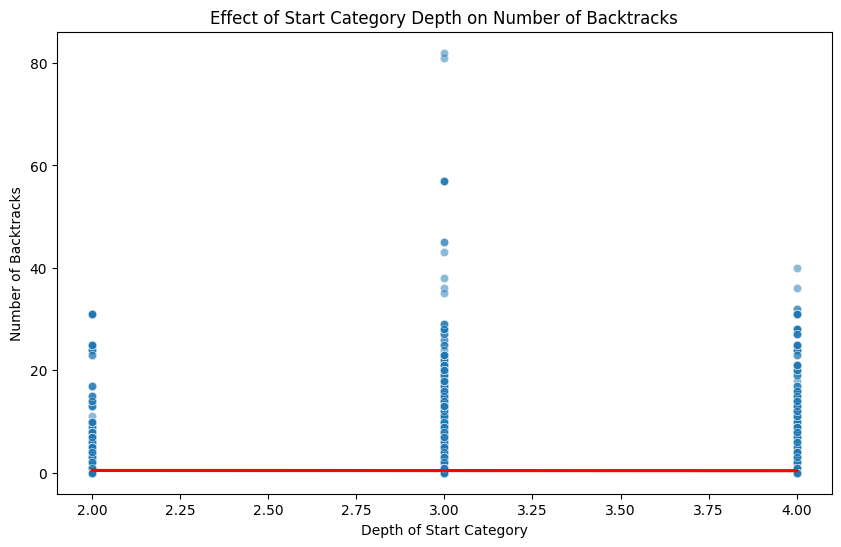

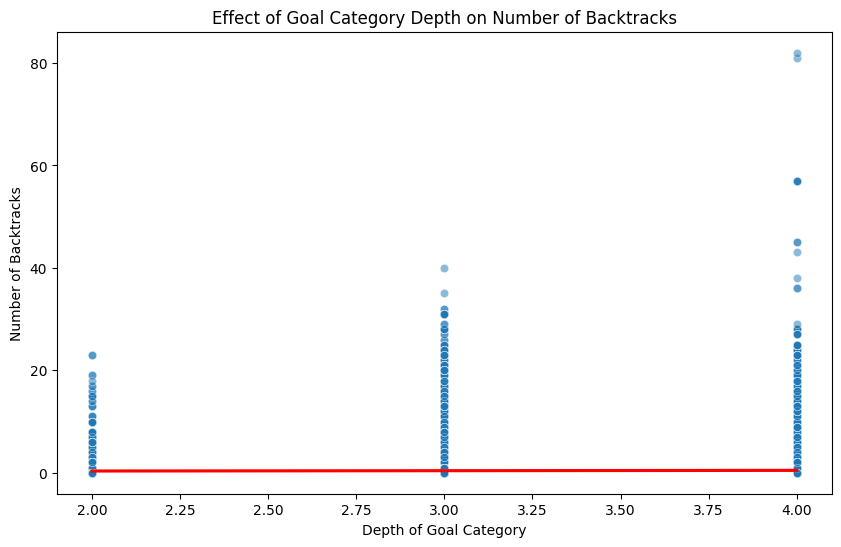

In [ ]:
# Merge the paths data with the categories data to get the depth information
paths_with_depth = paths.merge(categories[['article', 'depth']], left_on='start', right_on='article', how='left', suffixes=('', '_start'))
paths_with_depth = paths_with_depth.merge(categories[['article', 'depth']], left_on='target', right_on='article', how='left', suffixes=('', '_goal'))

# Plot the relationship between the depth of the start category and the number of backtracks
plt.figure(figsize=(10, 6))
sns.scatterplot(data=paths_with_depth, x='depth', y='backtracks', alpha=0.5)
sns.regplot(data=paths_with_depth, x='depth', y='backtracks', scatter=False, color='red')
plt.title('Effect of Start Category Depth on Number of Backtracks')
plt.xlabel('Depth of Start Category')
plt.ylabel('Number of Backtracks')
plt.show()

# Plot the relationship between the depth of the goal category and the number of backtracks
plt.figure(figsize=(10, 6))
sns.scatterplot(data=paths_with_depth, x='depth_goal', y='backtracks', alpha=0.5)
sns.regplot(data=paths_with_depth, x='depth_goal', y='backtracks', scatter=False, color='red')
plt.title('Effect of Goal Category Depth on Number of Backtracks')
plt.xlabel('Depth of Goal Category')
plt.ylabel('Number of Backtracks')
plt.show()

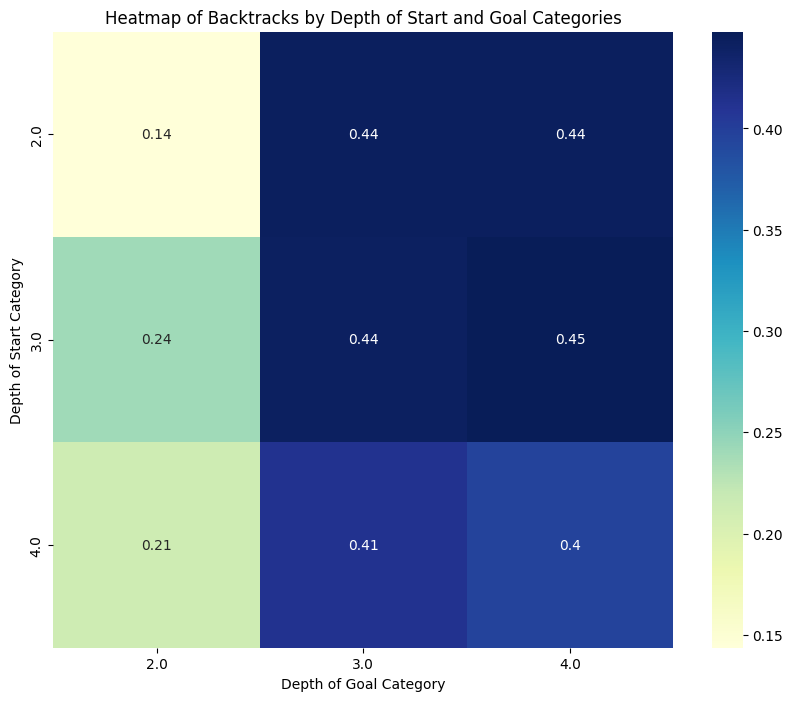

In [ ]:
# Create a pivot table with the depth of start and goal categories and the mean number of backtracks
depth_matrix = paths_with_depth.pivot_table(index='depth', columns='depth_goal', values='backtracks', aggfunc='mean', fill_value=0)

# Visualize the matrix using a heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(depth_matrix, annot=True, cmap='YlGnBu')
plt.title('Heatmap of Backtracks by Depth of Start and Goal Categories')
plt.xlabel('Depth of Goal Category')
plt.ylabel('Depth of Start Category')
plt.show()

In [ ]:
%pip install networkx
%pip install scikit-learn

Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.


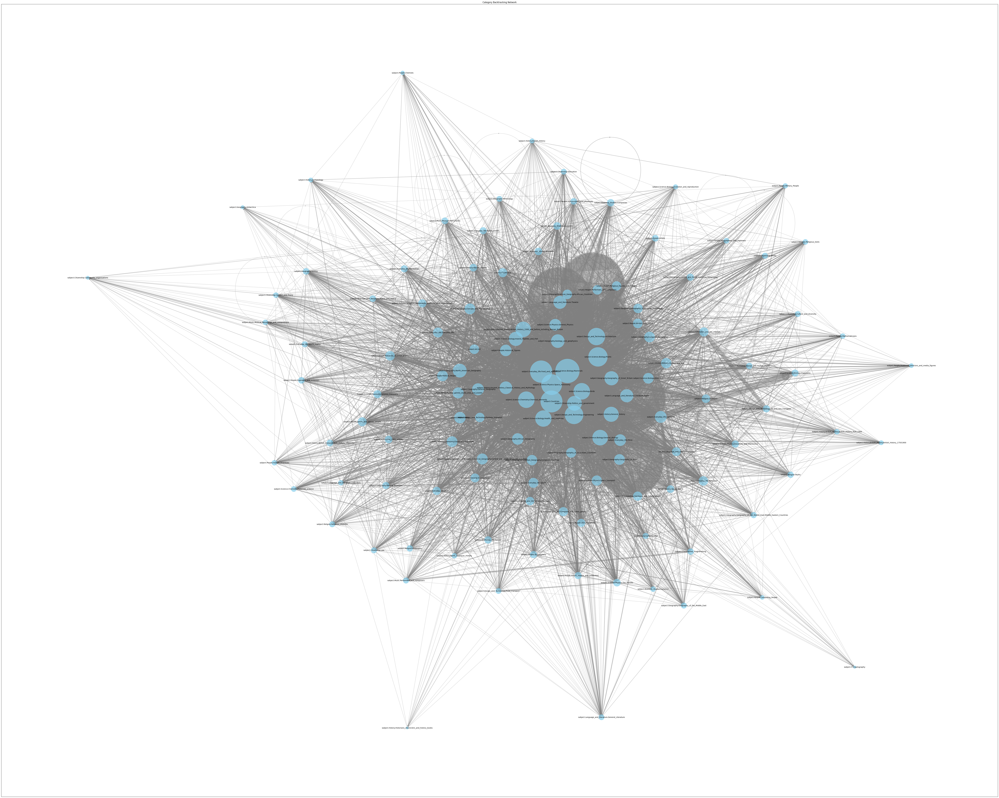

In [ ]:
import networkx as nx

# Step 1: Data Preparation
# Identify all unique category pairs where users have backtracked
backtracking_pairs = paths[paths['backtracks'] > 0].groupby(['category_start', 'category_goal']).size().reset_index(name='backtrack_count')

# Step 2: Building the Network
# Create a directed graph
G = nx.DiGraph()

# Add nodes and edges with weights
for _, row in backtracking_pairs.iterrows():
    G.add_edge(row['category_start'], row['category_goal'], weight=row['backtrack_count'])

# Step 3: Visualizing the Network
# Set node size based on total backtracking count for each category
node_sizes = [G.degree(node, weight='weight') * 10 for node in G.nodes()]

# Set edge thickness based on weight (backtracking frequency)
edge_weights = [G[u][v]['weight'] for u, v in G.edges()]

# Draw the network
plt.figure(figsize=(100, 80))
pos = nx.spring_layout(G, k=0.1)  # Position nodes using Fruchterman-Reingold force-directed algorithm

# Draw nodes
nx.draw_networkx_nodes(G, pos, node_size=node_sizes, node_color='skyblue', alpha=0.7)

# Draw edges
nx.draw_networkx_edges(G, pos, width=edge_weights, alpha=0.5, edge_color='gray')

# Draw labels
nx.draw_networkx_labels(G, pos, font_size=10, font_color='black')

plt.title('Category Backtracking Network')
plt.show()

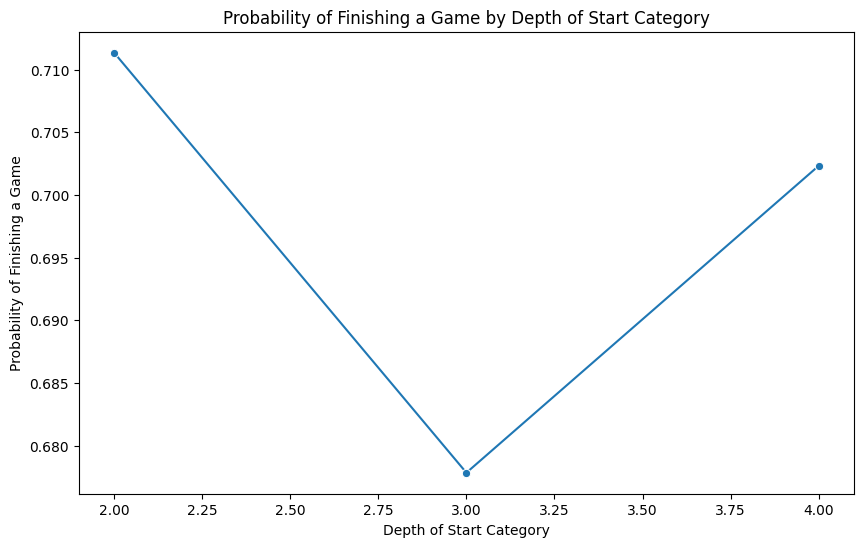

In [ ]:
# Calculate the probability of finishing a game for each depth level
depth_finish_prob = paths_with_depth.groupby('depth')['is_finished'].mean().reset_index()

# Plot the relationship between the depth and the probability of finishing a game
plt.figure(figsize=(10, 6))
sns.lineplot(data=depth_finish_prob, x='depth', y='is_finished', marker='o')
plt.title('Probability of Finishing a Game by Depth of Start Category')
plt.xlabel('Depth of Start Category')
plt.ylabel('Probability of Finishing a Game')
plt.show()

In [ ]:
# Count the number of unfinished games for each start category
paths_unfinished= paths[paths['is_finished'] == False]
unfinished_counts = paths_unfinished.groupby('category_start').size().reset_index(name='unfinished_counts')

# Calculate the total number of games for each start category
total_counts = paths.groupby('category_start').size().reset_index(name='total_counts')

# Merge the unfinished counts with the total counts
dead_end_analysis = unfinished_counts.merge(total_counts, on='category_start')

# Calculate the proportion of unfinished games for each start category
dead_end_analysis['dead_end_ratio'] = dead_end_analysis['unfinished_counts'] / dead_end_analysis['total_counts']

# Sort the categories by the dead-end ratio in descending order
dead_end_analysis = dead_end_analysis.sort_values(by='dead_end_ratio', ascending=False)

# Display the top categories that constitute dead-ends most often
print(dead_end_analysis.head(10))


                                        category_start  unfinished_counts  \
16          subject.Design_and_Technology.Architecture               2065   
78             subject.Language_and_literature.Theatre               1043   
75    subject.Language_and_literature.Literature_types               1002   
113            subject.Science.Biology.General_Biology               1321   
15   subject.Design_and_Technology.Air_and_Sea_tran...                185   
7               subject.Citizenship.Conflict_and_Peace                 61   
125            subject.Science.Physics.Space_Astronomy               1934   
67                     subject.IT.Computer_Programming                102   
90            subject.People.Geographers_and_explorers                 90   
80                   subject.Music.Musical_Instruments                100   

     total_counts  dead_end_ratio  
16           3763        0.548764  
78           2253        0.462938  
75           2208        0.453804  
113     

/var/folders/hy/zygvvrm928n5d36wdcsnnkg40000gn/T/ipykernel_39086/808038969.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=dead_end_analysis, x='dead_end_ratio', y='category_start', palette='viridis')


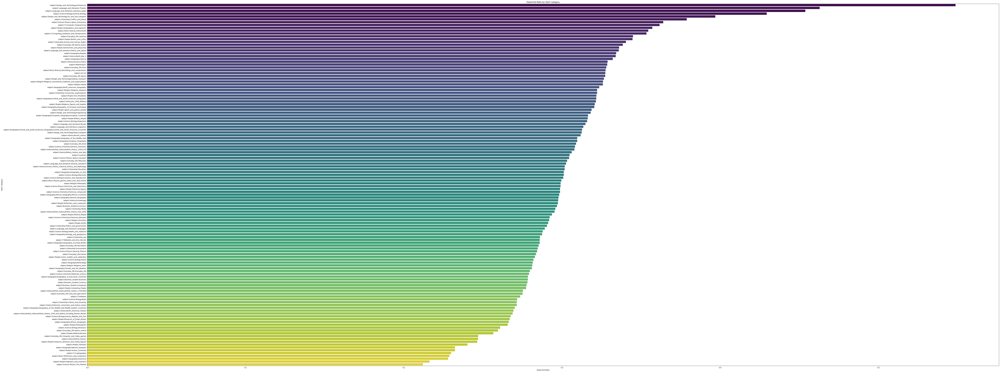

In [ ]:
# Bar plot for dead-end ratio
plt.figure(figsize=(100, 40))
sns.barplot(data=dead_end_analysis, x='dead_end_ratio', y='category_start', palette='viridis')
plt.title('Dead-End Ratio by Start Category')
plt.xlabel('Dead-End Ratio')
plt.ylabel('Start Category')
plt.show()

In [ ]:
import numpy as np

def load_distance_matrix(filepath):

    # Read the file and create matrix
    matrix = []
    with open(filepath, 'r') as file:
        for line in file:
            # Skip comment lines and empty lines
            if line.startswith('#') or not line.strip():
                continue
            # Convert each character to integer, ignoring underscores
            row = [int(char.replace('_', '-1')) for char in line.strip()]
            matrix.append(row)
    
    return np.array(matrix)

filepath = "wikispeedia_paths-and-graph/shortest-path-distance-matrix.txt"
distance_matrix = load_distance_matrix(filepath)
print(distance_matrix.shape)

(4604, 4604)


# Calculate the average backtrack count for each category
average_backtracks = paths.groupby('category_start')['backtracks'].mean().reset_index()

# Merge the average backtrack count with the distance matrix
category_backtrack_matrix = distance_matrix.copy()
for i, category in enumerate(average_backtracks['category_start']):
    category_backtrack_matrix[i, :] = average_backtracks.loc[average_backtracks['category_start'] == category, 'backtracks'].values

# Visualize the matrix using a heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(category_backtrack_matrix, annot=True, cmap='YlGnBu')
plt.title('Heatmap of Average Backtracks by Category')
plt.xlabel('Category Index')
plt.ylabel('Category Index')
plt.show()

In [ ]:
%pip install holoviews
%pip install bokeh
%pip install hvplot



Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.


/var/folders/hy/zygvvrm928n5d36wdcsnnkg40000gn/T/ipykernel_39086/3803141134.py:9: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.




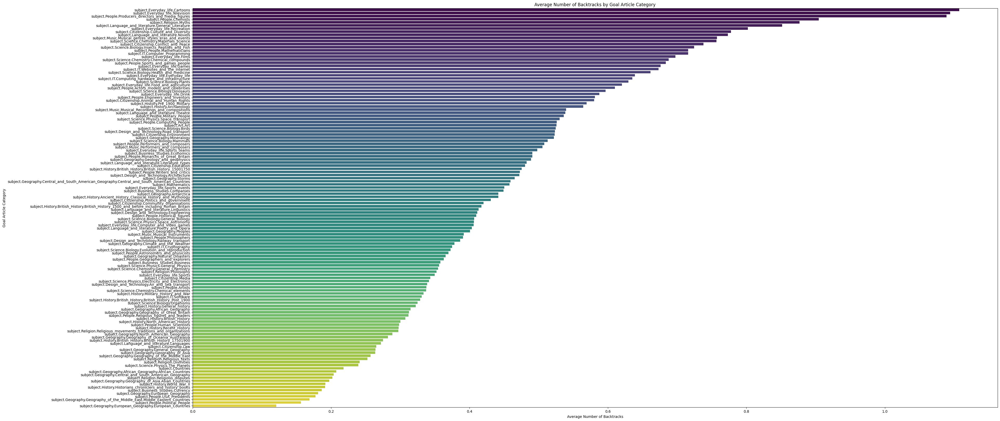

In [ ]:
# Calculate the average number of backtracks for each goal article category
backtracks_by_goal = paths.groupby('category_goal')['backtracks'].mean().reset_index()

# Sort the categories by the average number of backtracks
backtracks_by_goal = backtracks_by_goal.sort_values(by='backtracks', ascending=False)

# Plot the data
plt.figure(figsize=(40, 20))
sns.barplot(data=backtracks_by_goal, x='backtracks', y='category_goal', palette='viridis')
plt.title('Average Number of Backtracks by Goal Article Category')
plt.xlabel('Average Number of Backtracks')
plt.ylabel('Goal Article Category')
plt.show()